##### Copyright 2023 The MediaPipe Authors. All Rights Reserved.

In [3]:
#@title Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# Hand Landmarks Detection with MediaPipe Tasks

This notebook shows you how to use MediaPipe Tasks Python API to detect hand landmarks from images.

## Preparation

Let's start with installing MediaPipe.

In [ ]:
!pip install -q mediapipe

Then download an off-the-shelf model bundle. Check out the [MediaPipe documentation](https://developers.google.com/mediapipe/solutions/vision/hand_landmarker#models) for more information about this model bundle.

In [ ]:
!wget -q https://storage.googleapis.com/mediapipe-models/hand_landmarker/hand_landmarker/float16/1/hand_landmarker.task

## Visualization utilities

In [4]:
#@markdown We implemented some functions to visualize the hand landmark detection results. <br/> Run the following cell to activate the functions.

from mediapipe import solutions
from mediapipe.framework.formats import landmark_pb2
import numpy as np

MARGIN = 10  # pixels
FONT_SIZE = 1
FONT_THICKNESS = 1
HANDEDNESS_TEXT_COLOR = (88, 205, 54) # vibrant green

def draw_landmarks_on_image(rgb_image, detection_result):
  hand_landmarks_list = detection_result.hand_landmarks
  handedness_list = detection_result.handedness
  annotated_image = np.copy(rgb_image)

  # Loop through the detected hands to visualize.
  for idx in range(len(hand_landmarks_list)):
    hand_landmarks = hand_landmarks_list[idx]
    handedness = handedness_list[idx]

    # Draw the hand landmarks.
    hand_landmarks_proto = landmark_pb2.NormalizedLandmarkList()
    hand_landmarks_proto.landmark.extend([
      landmark_pb2.NormalizedLandmark(x=landmark.x, y=landmark.y, z=landmark.z) for landmark in hand_landmarks
    ])
    solutions.drawing_utils.draw_landmarks(
      annotated_image,
      hand_landmarks_proto,
      solutions.hands.HAND_CONNECTIONS,
      solutions.drawing_styles.get_default_hand_landmarks_style(),
      solutions.drawing_styles.get_default_hand_connections_style())

    # Get the top left corner of the detected hand's bounding box.
    height, width, _ = annotated_image.shape
    x_coordinates = [landmark.x for landmark in hand_landmarks]
    y_coordinates = [landmark.y for landmark in hand_landmarks]
    text_x = int(min(x_coordinates) * width)
    text_y = int(min(y_coordinates) * height) - MARGIN

    # Draw handedness (left or right hand) on the image.
    cv2.putText(annotated_image, f"{handedness[0].category_name}",
                (text_x, text_y), cv2.FONT_HERSHEY_DUPLEX,
                FONT_SIZE, HANDEDNESS_TEXT_COLOR, FONT_THICKNESS, cv2.LINE_AA)

  return annotated_image

## Download test image

Let's grab a test image that we'll use later. The image is from [Unsplash](https://unsplash.com/photos/mt2fyrdXxzk).

In [ ]:
!wget -q -O image.jpg https://storage.googleapis.com/mediapipe-tasks/hand_landmarker/woman_hands.jpg

import cv2
from google.colab.patches import cv2_imshow

img = cv2.imread("image.jpg")
cv2_imshow(img)

Optionally, you can upload your own image. If you want to do so, uncomment and run the cell below.

In [12]:
from google.colab import files
uploaded = files.upload()

for filename in uploaded:
  content = uploaded[filename]
  with open(filename, 'wb') as f:
    f.write(content)

if len(uploaded.keys()):
  IMAGE_FILE = next(iter(uploaded))
  print('Uploaded file:', IMAGE_FILE)

Saving VID_20250106_155627 - Trim.mp4 to VID_20250106_155627 - Trim (1).mp4
Uploaded file: VID_20250106_155627 - Trim (1).mp4


## Running inference and visualizing the results

Here are the steps to run hand landmark detection using MediaPipe.

Check out the [MediaPipe documentation](https://developers.google.com/mediapipe/solutions/vision/hand_landmarker/python) to learn more about configuration options that this solution supports.


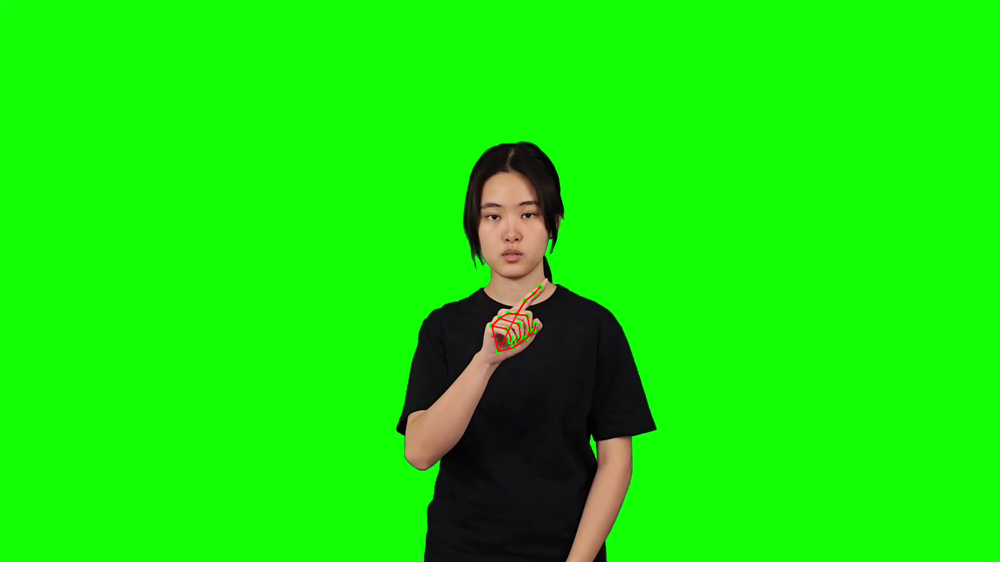

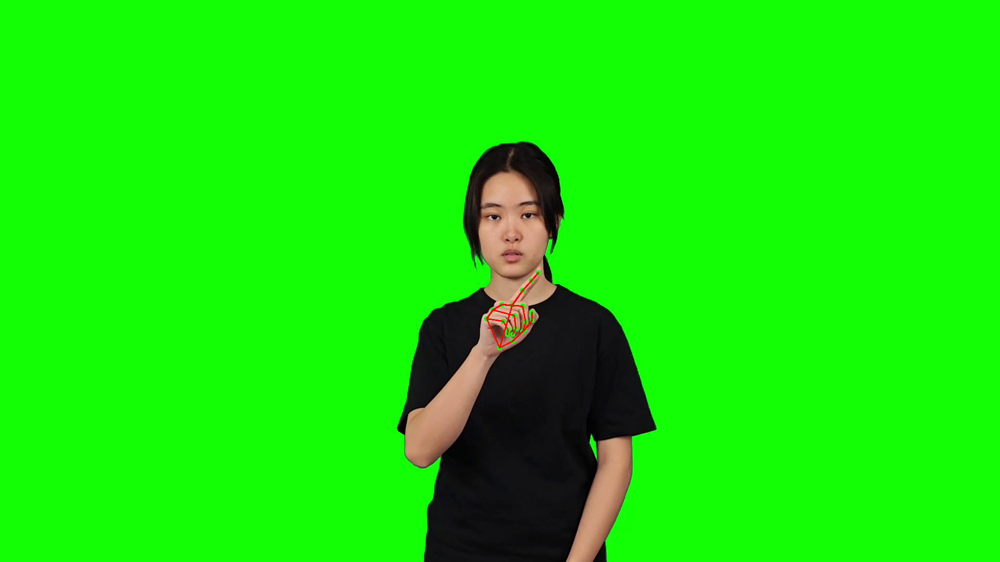

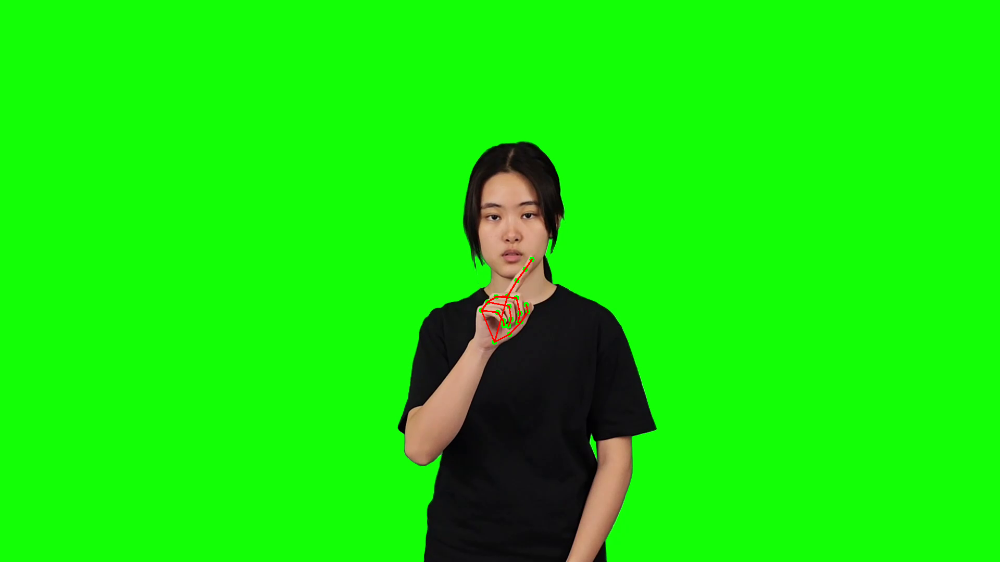

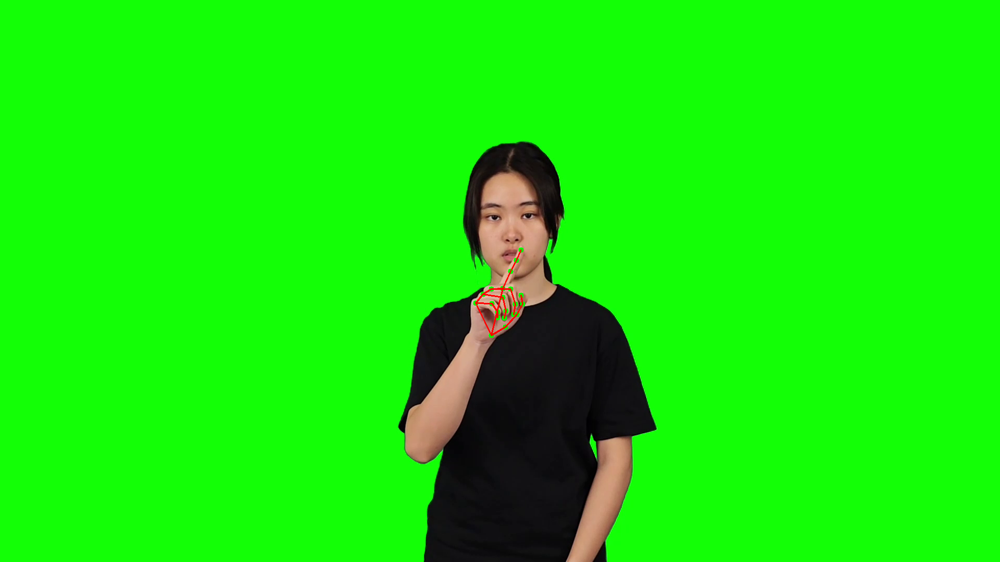

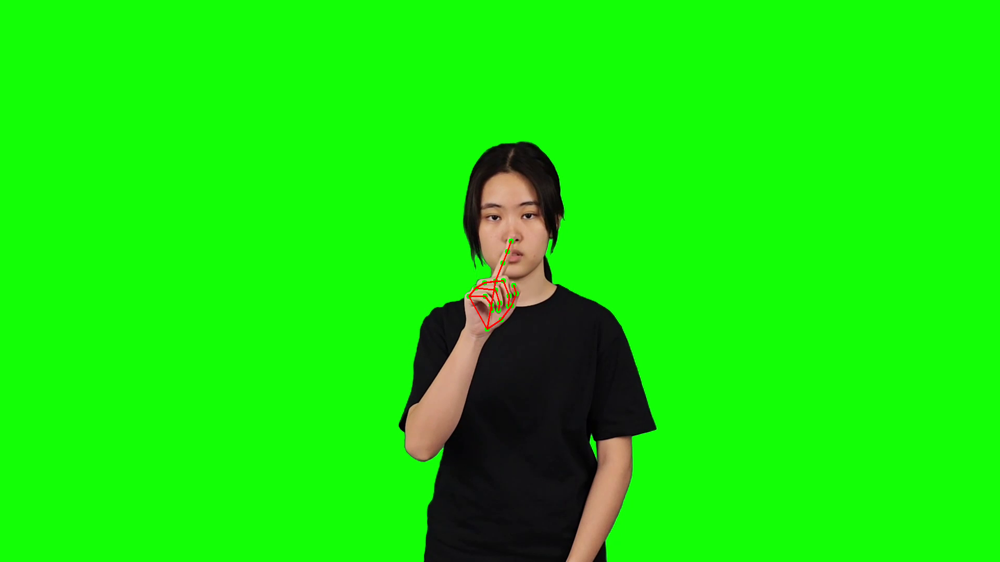

...

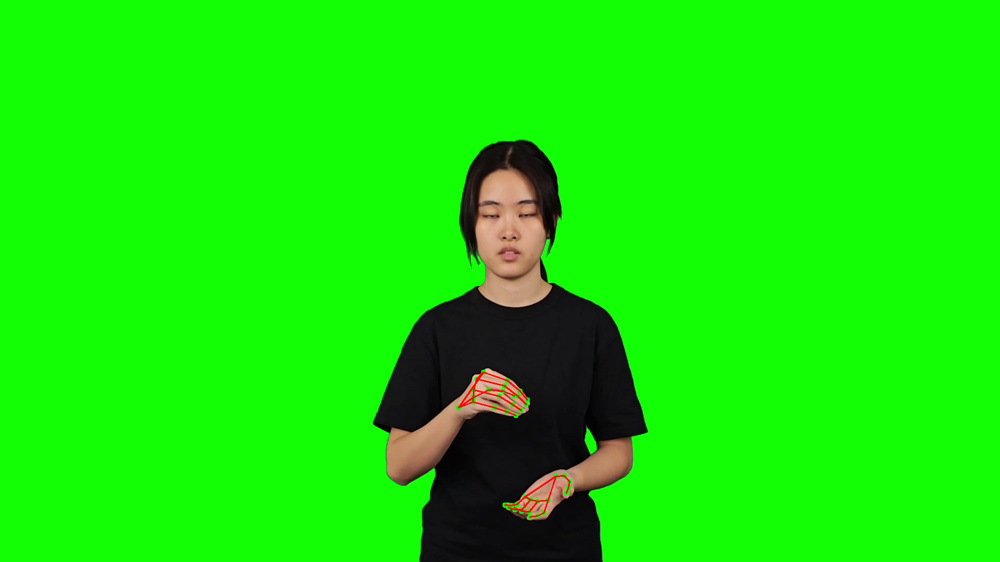

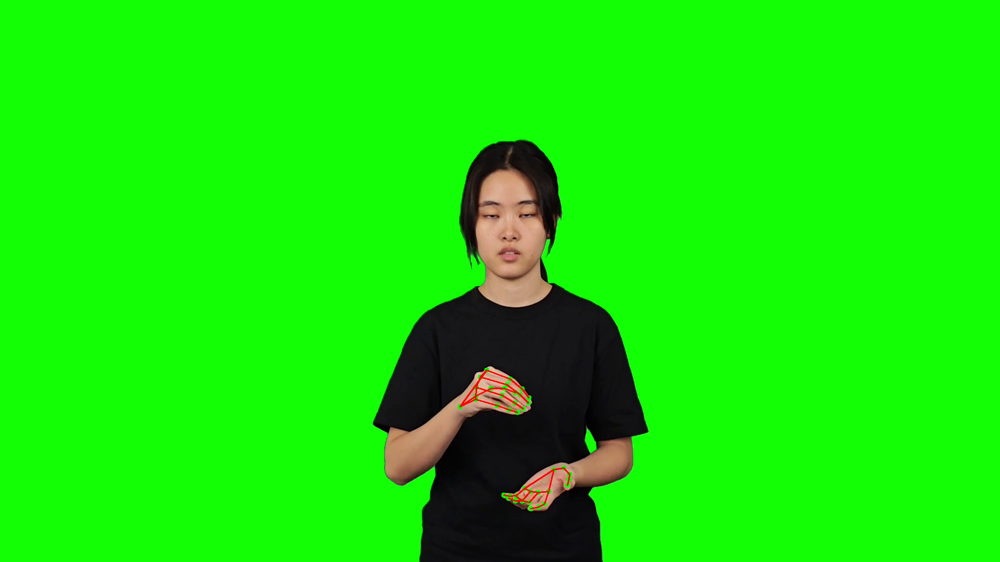

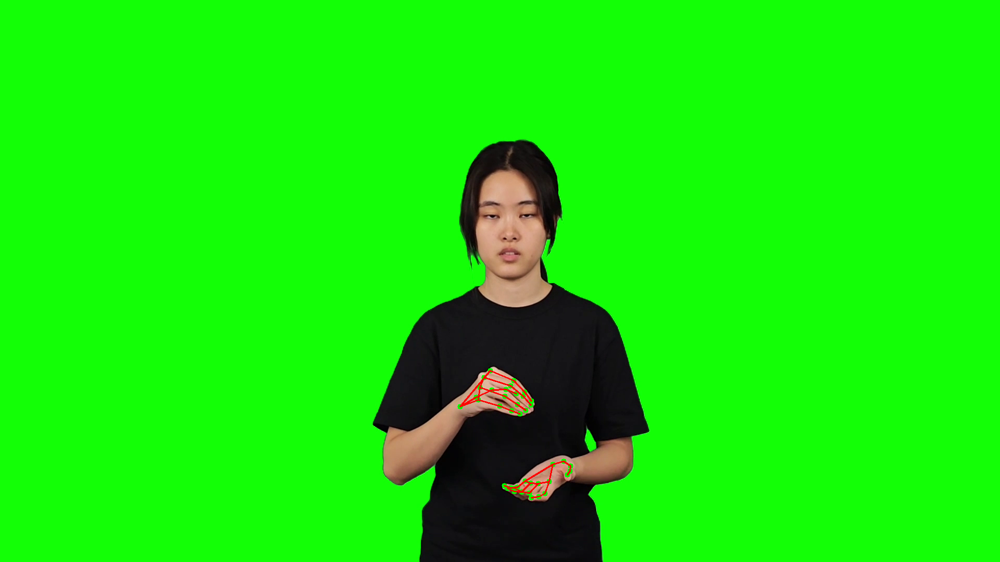

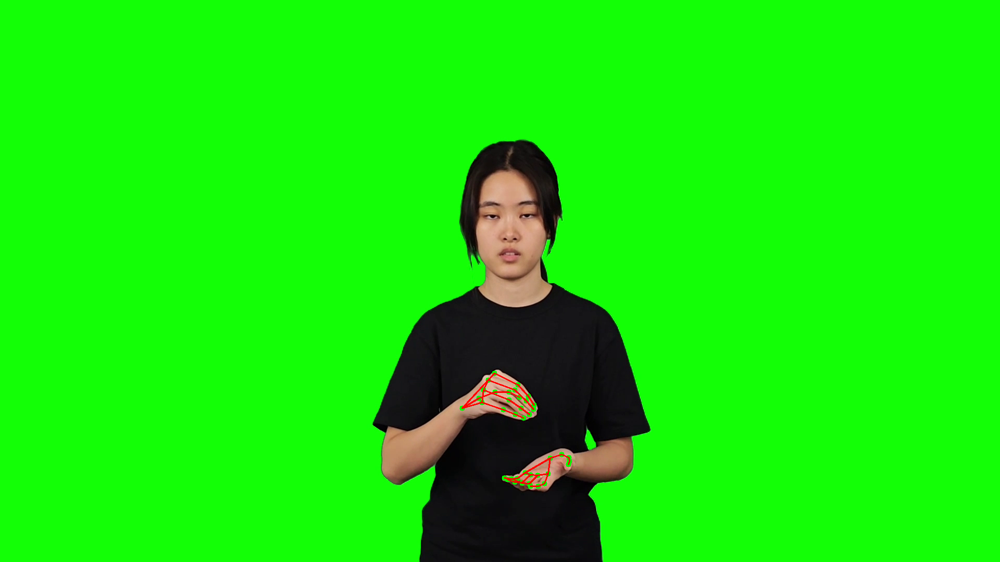

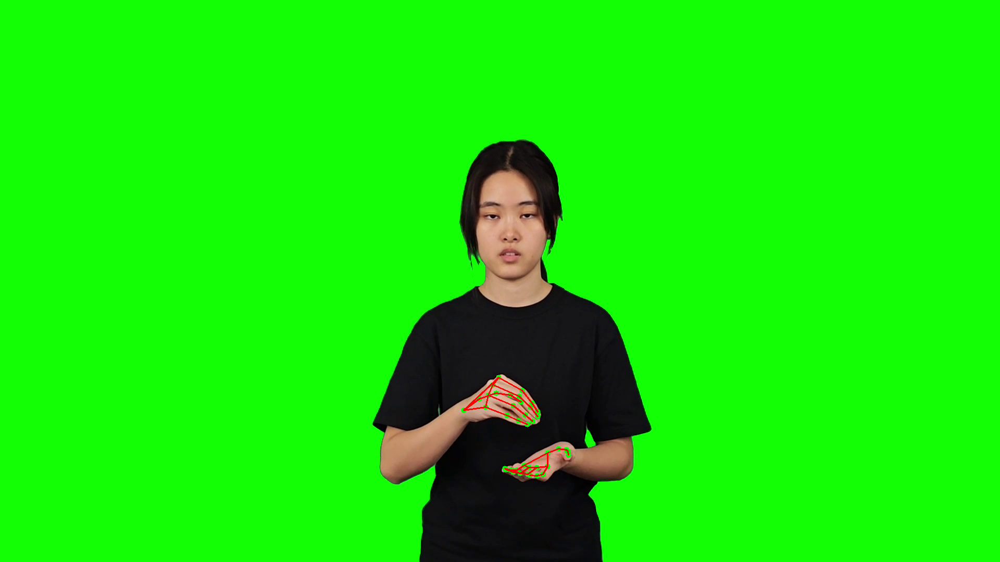

KeyboardInterrupt: 

In [13]:
# STEP 1: 导入所需模块
import cv2
import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision
from google.colab.patches import cv2_imshow  # 用于在 Colab 中显示图像

# STEP 2: 定义关键点可视化函数
def draw_landmarks_on_image(rgb_image, detection_result):
    # 手部关键点连接关系（MediaPipe定义的21个关键点之间的连接）
    HAND_CONNECTIONS = mp.solutions.hands.HAND_CONNECTIONS

    annotated_image = rgb_image.copy()
    img_height, img_width, _ = annotated_image.shape

    # 遍历每个检测到的手
    for hand_landmarks in detection_result.hand_landmarks:
        # 绘制关键点
        for landmark in hand_landmarks:
            x = int(landmark.x * img_width)
            y = int(landmark.y * img_height)
            cv2.circle(annotated_image, (x, y), 5, (0, 255, 0), -1)  # 绿色实心圆点

        # 绘制连接线
        for connection in HAND_CONNECTIONS:
            start_idx = connection[0]
            end_idx = connection[1]

            start_point = (int(hand_landmarks[start_idx].x * img_width),
                          int(hand_landmarks[start_idx].y * img_height))

            end_point = (int(hand_landmarks[end_idx].x * img_width),
                        int(hand_landmarks[end_idx].y * img_height))

            cv2.line(annotated_image, start_point, end_point, (255, 0, 0), 2)  # 蓝色连接线

    return annotated_image

# STEP 3: 创建HandLandmarker对象
base_options = python.BaseOptions(model_asset_path='hand_landmarker.task')
options = vision.HandLandmarkerOptions(
    base_options=base_options,
    num_hands=2,
    running_mode=mp.tasks.vision.RunningMode.VIDEO,  # 运行模式为视频
)

detector = vision.HandLandmarker.create_from_options(options)

# STEP 4: 打开视频文件
video_path = 'VID_20250106_155627 - Trim.mp4'  # 替换为你的视频路径
cap = cv2.VideoCapture(video_path)

# 检查视频是否成功打开
if not cap.isOpened():
    raise IOError(f"无法打开视频文件: {video_path}")

# STEP 5: 获取视频参数
fps = cap.get(cv2.CAP_PROP_FPS)
frame_count = 0
prev_timestamp_ms = -1  # 用于确保时间戳严格递增

# STEP 6: 主循环处理视频帧
while True:
    # 读取帧
    success, frame = cap.read()
    if not success:
        break

    # 颜色空间转换
    rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

    # 创建MediaPipe图像对象
    mp_image = mp.Image(image_format=mp.ImageFormat.SRGB, data=rgb_frame)

    # 计算时间戳（确保严格递增）
    current_timestamp_ms = int(frame_count * (1000 / fps))
    if current_timestamp_ms <= prev_timestamp_ms:
        current_timestamp_ms = prev_timestamp_ms + 1

    # 执行手势识别
    detection_result = detector.detect_for_video(mp_image, current_timestamp_ms)

    # 更新前一时间戳记录
    prev_timestamp_ms = current_timestamp_ms

    # 可视化关键点
    if detection_result.hand_landmarks:
        annotated_image = draw_landmarks_on_image(rgb_frame.copy(), detection_result)
        display_frame = cv2.cvtColor(annotated_image, cv2.COLOR_RGB2BGR)

        # 在 Colab 中显示图像
        cv2_imshow(display_frame)

        # 按q键退出（Colab 中无法直接使用 cv2.waitKey）
        # 可以使用 IPython 的交互功能或手动终止循环
        # break  # 这里只处理一帧，避免无限显示

    frame_count += 1

# STEP 7: 释放资源
cap.release()
detector.close()
print(f"共处理 {frame_count} 帧")
